In [2]:
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, random_split, DataLoader
import numpy as np
import torch.nn.functional as F

In [3]:
import torchvision
from torchvision import datasets
train_data =datasets.MNIST(root="data",train=True,download=True,transform=torchvision.transforms.ToTensor())
train_data,val_data=random_split(train_data,[50000,10000])
test_data =datasets.MNIST(root="data",train=False,download=True,transform=torchvision.transforms.ToTensor())

100%|██████████| 9.91M/9.91M [00:00<00:00, 36.7MB/s]
100%|██████████| 28.9k/28.9k [00:00<00:00, 1.01MB/s]
100%|██████████| 1.65M/1.65M [00:00<00:00, 9.30MB/s]
100%|██████████| 4.54k/4.54k [00:00<00:00, 7.08MB/s]


In [4]:
train_data[0][0].reshape(784).shape

torch.Size([784])

In [5]:
device="cuda" if torch.cuda.is_available() else "cpu"
print(f"Using {device} device")

Using cpu device


1. COMPARING PCA AND AUTOENCODERS

In [17]:
from sklearn.decomposition import PCA
pca=PCA(n_components=30)
container=np.zeros((len(train_data),784))
for i in range(len(train_data)):
    data=train_data[i][0].reshape(784).numpy()
    container[i]=data
print(container.shape)
new_container=pca.fit_transform(container)
final_container=pca.inverse_transform(new_container)

(50000, 784)


MSE of PCA : 0.018516837608128108


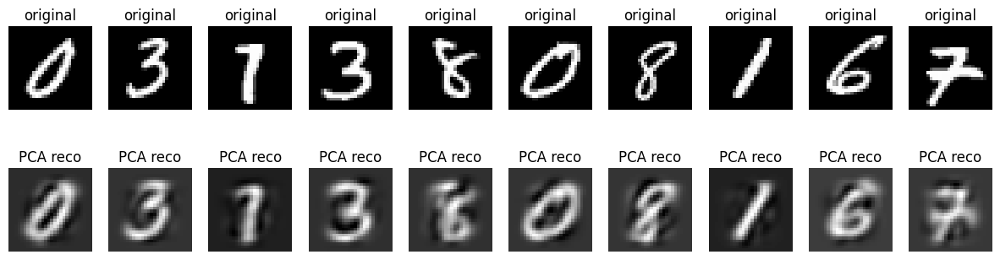

In [20]:
plt.figure(figsize=(15, 4))
random_test=np.random.randint(0,50000,(10,))
index=0
error=0
loss_fn = nn.MSELoss() # Initialize the loss function
for i in random_test:
  original_img=train_data[i][0].reshape(28,28)
  reconstructed_img=final_container[i].reshape(28,28)
  ax=plt.subplot(2,len(random_test),index+1)
  plt.imshow(original_img,cmap="gray")
  ax.set_title("original")
  ax.axis("off")
  ax=plt.subplot(2,len(random_test),index+1+len(random_test))
  plt.imshow(reconstructed_img,cmap="gray")
  ax.set_title("PCA reco")
  ax.axis("off")
  index+=1
  # Calculate the loss using the initialized loss function
  error+=loss_fn(torch.from_numpy(reconstructed_img), original_img).item() # Convert reconstructed_img to tensor and calculate loss
print(f"MSE of PCA : {error/len(random_test)}")

In [10]:
class encoder_decoder(nn.Module):
  def __init__(self):
    super().__init__()
    #encoder
    self.layer_1=nn.Linear(784,512)
    self.layer_2=nn.Linear(512,256)
    self.layer_3=nn.Linear(256,128)
    self.layer_4=nn.Linear(128,30)
    #decoder
    self.layer_5=nn.Linear(30,128)
    self.layer_6=nn.Linear(128,256)
    self.layer_7=nn.Linear(256,784)
    self.act=nn.ReLU()
    self.act_2=nn.Sigmoid()

  def forward(self,x):
    out_1=self.act(self.layer_1(x))
    out_2=self.act(self.layer_2(out_1))
    out_3=self.act(self.layer_3(out_2))
    out_4=self.act(self.layer_4(out_3))
    out_5=self.act(self.layer_5(out_4))
    out_6=self.act(self.layer_6(out_5))
    out_7=self.act_2(self.layer_7(out_6))
    return out_4,out_7

In [11]:
def train_model(model,train_loader,val_loader,loss_fn,optimizer,epochs):
  train_loss=[]
  val_loss=[]
  for i in range(epochs):
    model.train()
    runn_loss=0
    for data in train_loader:
      data = data[0].to(device)  # Move data to the device
      optimizer.zero_grad()
      _,output=model.forward(data.reshape(len(data),784)) # Unpack the tuple and get the output
      loss=loss_fn(output,data.reshape(len(data),784))
      loss.backward()
      optimizer.step()
      runn_loss+=loss.item()
    train_loss.append(runn_loss/len(train_loader))
    model.eval()
    runn_loss=0
    with torch.no_grad():
      for val in val_loader:
        val=val[0].to(device)
        _,output=model.forward(val.reshape(len(val),784)) # Unpack the tuple and get the output
        loss=loss_fn(output,val.reshape(len(val),784))
        runn_loss+=loss.item()
      val_loss.append(runn_loss/len(val_loader))
    print(f"epoch {i+1} | train loss {train_loss[-1]} | val loss : {val_loss[-1]}")

In [8]:
train_loader=DataLoader(train_data,batch_size=64,shuffle=True)
val_loader=DataLoader(val_data,batch_size=64,shuffle=True)
test_loader=DataLoader(test_data,batch_size=32,shuffle=False)

In [12]:
model=encoder_decoder()
loss_fn=nn.MSELoss()
optimizer=torch.optim.Adam(model.parameters(),lr=0.001)
train_model(model,train_loader,val_loader,loss_fn,optimizer,15)

epoch 1 | train loss 0.04904984937185217 | val loss : 0.03021080595008127
epoch 2 | train loss 0.02529033513315727 | val loss : 0.021443881367327302
epoch 3 | train loss 0.019755540875351186 | val loss : 0.01839752135810199
epoch 4 | train loss 0.017443512697392107 | val loss : 0.01652801702404098
epoch 5 | train loss 0.01576252107072593 | val loss : 0.015280826485887834
epoch 6 | train loss 0.014572085772195587 | val loss : 0.014414994751998953
epoch 7 | train loss 0.01373125761961731 | val loss : 0.013924766047175522
epoch 8 | train loss 0.013088802874917189 | val loss : 0.013161021308487009
epoch 9 | train loss 0.012494849449600024 | val loss : 0.01260102964985143
epoch 10 | train loss 0.012027097116831852 | val loss : 0.012236241399530013
epoch 11 | train loss 0.011586995401164837 | val loss : 0.011799991913851659
epoch 12 | train loss 0.011208601702061836 | val loss : 0.011607748509687224
epoch 13 | train loss 0.010863686068569455 | val loss : 0.011139604156231804
epoch 14 | train

MSE of AE : 0.010623048257548362


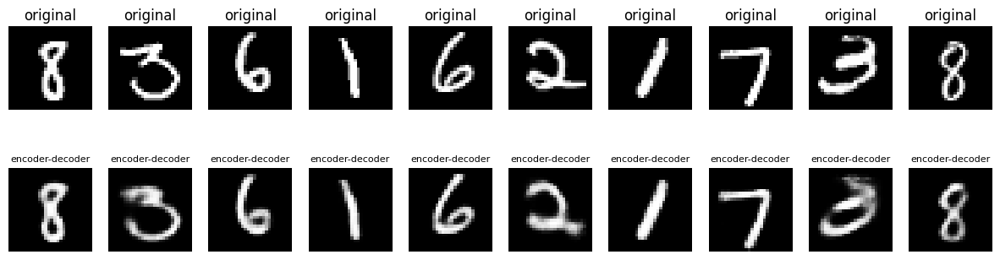

In [21]:
plt.figure(figsize=(15, 4))
random_test=np.random.randint(0,50000,(10,))
index=0
loss_fn=nn.MSELoss()
error=0
for i in random_test:
  original_img=train_data[i][0].reshape(28,28)
  ax=plt.subplot(2,len(random_test),index+1)
  plt.imshow(original_img,cmap="gray")
  ax.set_title("original")
  ax.axis("off")
  _,reconstructed_img=model(train_data[i][0].reshape(1,784))
  reconstructed_img=reconstructed_img.reshape(28,28)
  ax=plt.subplot(2,len(random_test),index+1+len(random_test))
  plt.imshow(reconstructed_img.detach().numpy(),cmap="gray")
  ax.set_title("encoder-decoder",size=8)
  ax.axis("off")
  index+=1
  error+=loss_fn(reconstructed_img,original_img).item()
print(f"MSE of AE : {error/len(random_test)}")

Linear vs. Non-linear: This is the most important difference. PCA is restricted to linear transformations. An AE, with its activation functions (like ReLU), can learn complex, curved, non-linear manifolds. MNIST digits don't just vary along straight lines, so an AE is expected to create a more meaningful and efficient compression.

Expected Outcome: As expected the Autoencoder has a lower reconstruction error (higher accuracy) than PCA. Its non-linear nature allows it to capture the underlying structure of the handwritten digits more effectively in 30 dimensions. The reconstructed digits from the AE should look clearer and more "digit-like" than those from PCA.

MSE of PCA : 0.018516837608128108

MSE of AE : 0.010623048257548362

Clearly AE outperforms


2. STANDARD AUTOENCODER

In [26]:
class standard_autoencoder(nn.Module):
  def __init__(self,x):
    super().__init__()
    self.encoder=nn.Linear(784,x)
    self.decoder=nn.Linear(x,784)
    self.act_1=nn.ReLU()
    self.act_2=nn.Sigmoid()
  def forward(self,data):
    o1= self.act_1(self.encoder(data))
    o2= self.act_2(self.decoder(o1))
    return o1,o2

Model_2 with hidden layer = 64

In [30]:
x=64
model_2=standard_autoencoder(64).to(device)
loss_fn=nn.MSELoss()
optimizer=torch.optim.Adam(model_2.parameters(),lr=0.001)
train_model(model_2,train_loader,val_loader,loss_fn,optimizer,15)

epoch 1 | train loss 0.03967106827508534 | val loss : 0.019688748226613755
epoch 2 | train loss 0.014355134535723787 | val loss : 0.01058815325355264
epoch 3 | train loss 0.008854476979735982 | val loss : 0.007742040259704278
epoch 4 | train loss 0.006887040464231349 | val loss : 0.00635481558763867
epoch 5 | train loss 0.006018403287538711 | val loss : 0.0058410418469007986
epoch 6 | train loss 0.005645426809597199 | val loss : 0.005549252504826921
epoch 7 | train loss 0.005452314906222436 | val loss : 0.0054183305377603335
epoch 8 | train loss 0.0052731821558836016 | val loss : 0.005256078238628662
epoch 9 | train loss 0.0051425518694302765 | val loss : 0.005143380857363438
epoch 10 | train loss 0.005050637090550093 | val loss : 0.005013721238726833
epoch 11 | train loss 0.004902263978839187 | val loss : 0.004949974679168623
epoch 12 | train loss 0.004852999019605653 | val loss : 0.0048729052179890455
epoch 13 | train loss 0.004820461646067764 | val loss : 0.00488865579282687
epoch 1

Model_3 with hidden_layer = 128

In [31]:
x=128
model_3=standard_autoencoder(128).to(device)
loss_fn=nn.MSELoss()
optimizer=torch.optim.Adam(model_3.parameters(),lr=0.001)
train_model(model_3,train_loader,val_loader,loss_fn,optimizer,15)

epoch 1 | train loss 0.031186283061095058 | val loss : 0.012922470944275143
epoch 2 | train loss 0.008826158173225077 | val loss : 0.006228157191590708
epoch 3 | train loss 0.005036709876909681 | val loss : 0.004199627448751289
epoch 4 | train loss 0.003725567110575964 | val loss : 0.0034415901884745073
epoch 5 | train loss 0.003094857728318371 | val loss : 0.002923819743642572
epoch 6 | train loss 0.0027245777615053043 | val loss : 0.002627312841937895
epoch 7 | train loss 0.0025033387066701147 | val loss : 0.002451570502891662
epoch 8 | train loss 0.0023436675146234023 | val loss : 0.0023433605689484223
epoch 9 | train loss 0.002230018539868695 | val loss : 0.0022449833148153156
epoch 10 | train loss 0.002131707722927346 | val loss : 0.0021550947196698586
epoch 11 | train loss 0.0020605599392465104 | val loss : 0.002103007799696628
epoch 12 | train loss 0.0020088350876410733 | val loss : 0.0020621071746098293
epoch 13 | train loss 0.001961988629326653 | val loss : 0.00200871702885717

Model_4 with hidden_layer = 256

In [32]:
x=256
model_4=standard_autoencoder(256).to(device)
loss_fn=nn.MSELoss()
optimizer=torch.optim.Adam(model_4.parameters(),lr=0.001)
train_model(model_4,train_loader,val_loader,loss_fn,optimizer,15)

epoch 1 | train loss 0.02383251315759271 | val loss : 0.00786039619083712
epoch 2 | train loss 0.005351482674388972 | val loss : 0.003811838576914209
epoch 3 | train loss 0.00314809337658498 | val loss : 0.00266034014754377
epoch 4 | train loss 0.002356647621736626 | val loss : 0.0021534105280865056
epoch 5 | train loss 0.0019627189992562585 | val loss : 0.0018829690377008478
epoch 6 | train loss 0.0017176436818897953 | val loss : 0.0016975165337359734
epoch 7 | train loss 0.0015528496007061066 | val loss : 0.0015498217333191234
epoch 8 | train loss 0.0014347329621424761 | val loss : 0.0014522436970643177
epoch 9 | train loss 0.0013455285506425402 | val loss : 0.0013763211796558492
epoch 10 | train loss 0.0012727127341396363 | val loss : 0.0013174270168480695
epoch 11 | train loss 0.0012064113852132082 | val loss : 0.0012536089538127944
epoch 12 | train loss 0.0011570029616620287 | val loss : 0.0011962236303414936
epoch 13 | train loss 0.0011138998849890278 | val loss : 0.0011694965903

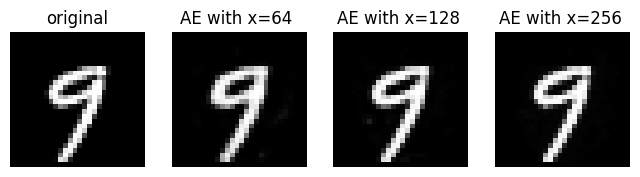

In [ ]:
plt.figure(figsize=(8, 2))
random_test=np.random.randint(0,10000,(1,))
index=0
x=[64,128,256]
for i in range(4):
  if i==0:
    original_img=test_data[random_test[0]][0].reshape(28,28)
    ax=plt.subplot(1,4,index+1)
    plt.imshow(original_img,cmap="gray")
    ax.set_title("original")
    plt.axis("off")
    index+=1
    continue

  elif i==1:
    model_=model_2


  elif i==2:
    model_=model_3

  elif i==3:
    model_=model_4

  model_.eval()
  with torch.no_grad():
    reconstructed_img=model_.forward(test_data[random_test[0]][0].reshape(1,784)).reshape(28,28)
  ax=plt.subplot(1,4,index+1)
  plt.imshow(reconstructed_img.detach().numpy(),cmap="gray")
  ax.set_title(f"AE with x={ x[i-1] } ")
  ax.axis("off")
  index+=1

Quality of reconstruction is proportional to the number of neurons in hidden layer x.

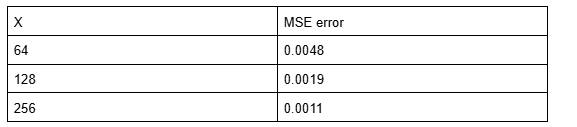


Clearly x=256 outperforms


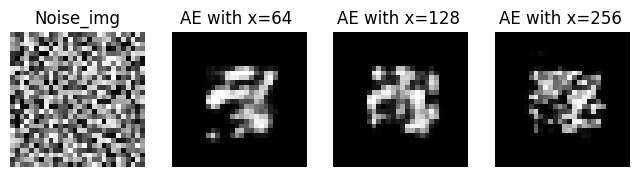

In [ ]:
noise_input=torch.rand(1,784)
index=0
plt.figure(figsize=(8, 2))
for i in range(4):
  if i==0:
    original_img=noise_input[0].reshape(28,28)
    ax=plt.subplot(1,4,index+1)
    plt.imshow(original_img.detach().numpy(),cmap="gray")
    ax.set_title("Noise_img")
    plt.axis("off")
    index+=1
    continue

  elif i==1:
    model_=model_2


  elif i==2:
    model_=model_3

  elif i==3:
    model_=model_4

  model_.eval()
  with torch.no_grad():
    reconstructed_img=model_.forward(noise_input).reshape(28,28)
  ax=plt.subplot(1,4,index+1)
  plt.imshow(reconstructed_img.detach().numpy(),cmap="gray")
  ax.set_title(f"AE with x={ x[i-1] } ")
  ax.axis("off")
  index+=1



When a random noise image is passed as input to the trained autoencoders, the models do not reconstruct the random noise. Instead, they output a blurry, abstract image that vaguely resembles a composite or superposition of different digits. The output is clearly not random static; it has a structure that is characteristic of the MNIST dataset.

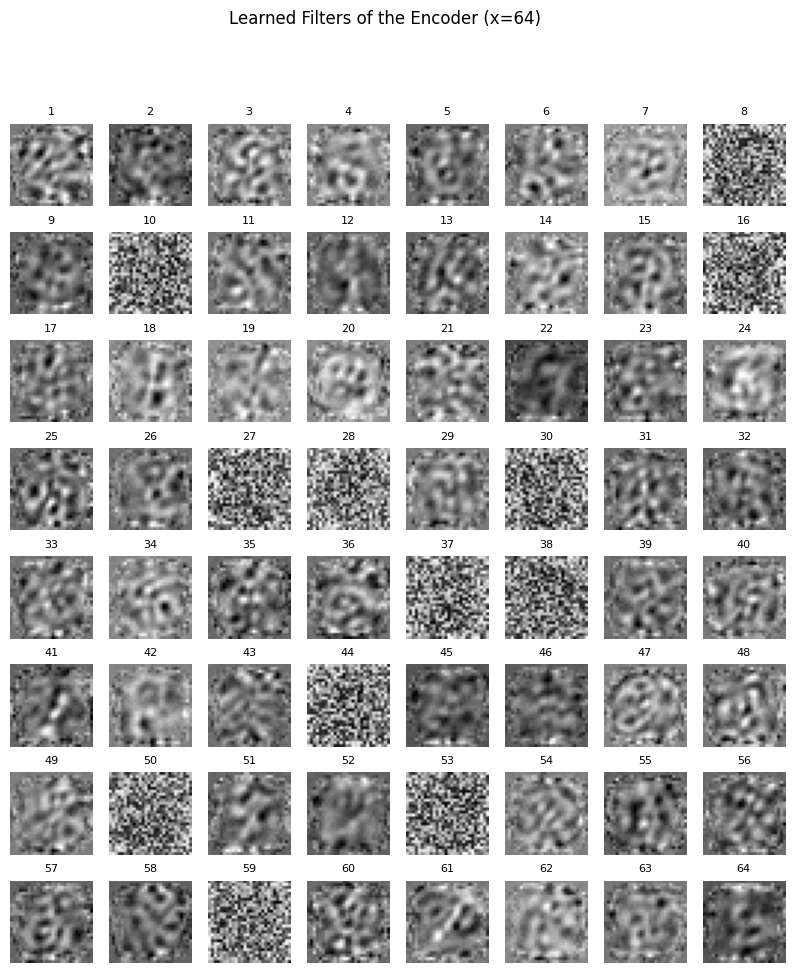

In [ ]:
filters_1 = model_2.encoder.weight.data.clone()
filters_2 = model_3.encoder.weight.data.clone()
filters_3 = model_4.encoder.weight.data.clone()
plt.figure(figsize=(10, 11))
for i in range(filters_1.shape[0]):
    ax = plt.subplot(8, 8, i + 1)
    plt.imshow(filters_1[i].reshape(28, 28), cmap='gray')
    ax.set_title(f"{i+1}",size=8)
    ax.axis('off')

plt.suptitle("Learned Filters of the Encoder (x=64)")
plt.show()

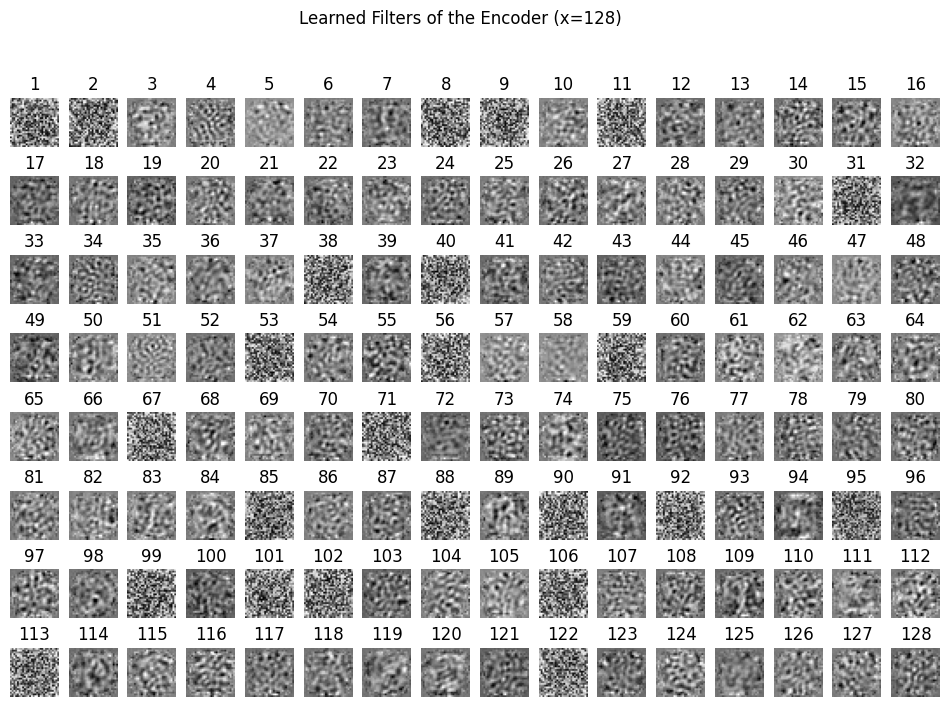

In [ ]:
plt.figure(figsize=(12,8))
for i in range(filters_2.shape[0]):
    ax = plt.subplot(8, 16, i + 1)
    plt.imshow(filters_2[i].reshape(28, 28), cmap='gray')
    ax.set_title(f"{i+1}")
    ax.axis('off')

plt.suptitle("Learned Filters of the Encoder (x=128)")
plt.show()

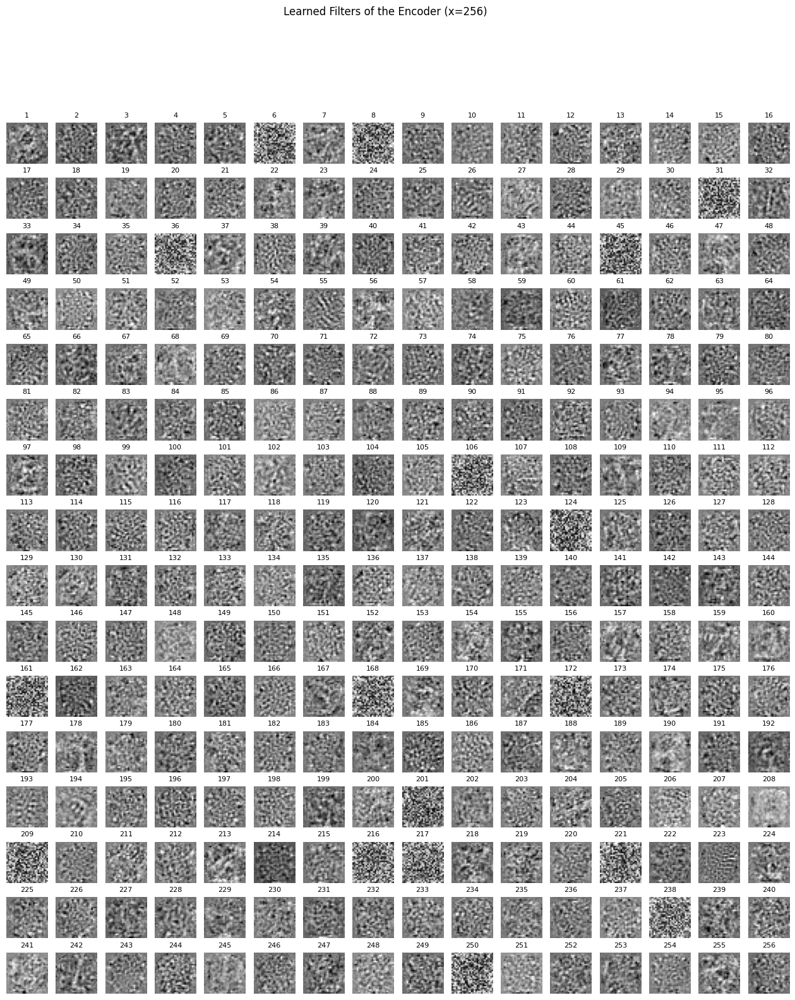

In [ ]:
plt.figure(figsize=(16,18))
for i in range(filters_3.shape[0]):
    ax = plt.subplot(16, 16, i + 1)
    plt.imshow(filters_3[i].reshape(28, 28), cmap='gray')
    ax.set_title(f"{i+1}",size=8)
    ax.axis('off')

plt.suptitle("Learned Filters of the Encoder (x=256)")
plt.show()

Observation:

As seen in your visualizations for x=64, x=128, and x=256, the learned filters are not random noise. They exhibit clear structures.

For x=64: The filters are the most interpretable. Many of them look like primitive shapes: soft diagonal strokes, gentle curves, loops, and corners. Some are more like gradients that detect blurry spots.

For x=128 and x=256: As the hidden dimension increases, the filters become slightly less distinct and more numerous. While some still represent clear strokes, others appear more complex or high-frequency, suggesting the network is learning more localized or redundant features.

3. Sparse Auto encoders

In [5]:
class sparse_auto_encoders(nn.Module):
  def __init__(self,x):
    super().__init__()
    self.encoder=nn.Linear(784,x)
    self.decoder=nn.Linear(x,784)
    self.act_1=nn.ReLU()
    self.act_2=nn.Sigmoid()

  def forward(self,data):
    o1= self.act_1(self.encoder(data))
    o2= self.act_2(self.decoder(o1))
    return o1,o2


In [24]:
def train_model_with_regularizer(model,train_loader,val_loader,loss_fn,lamda,optimizer,epochs):
  train_loss=[]
  val_loss=[]
  for i in range(epochs):
    model.train()
    runn_loss=0
    for data in train_loader:
      data = data[0].to(device)  # Move data to the device
      optimizer.zero_grad()
      h_act_out,output=model.forward(data.reshape(len(data),784))
      loss_1=loss_fn(output,data.reshape(len(data),784))
      loss_2=torch.abs(h_act_out).sum()
      loss=loss_1+lamda*loss_2
      loss.backward()
      optimizer.step()
      runn_loss+=loss.item()
    train_loss.append(runn_loss/len(train_loader))
    model.eval()
    runn_loss=0
    with torch.no_grad():
      for val in val_loader:
        val = val[0].to(device) # Move validation data to the device
        _,output=model.forward(val.reshape(len(val),784))
        loss=loss_fn(output,val.reshape(len(val),784))
        runn_loss+=loss.item()
      val_loss.append(runn_loss/len(val_loader))
    print(f"epoch {i+1} | train loss {train_loss[-1]} | val loss : {val_loss[-1]}")

In [46]:
model_5=sparse_auto_encoders(1024).to(device)
loss_fn=nn.MSELoss()
optimizer=torch.optim.Adam(model_5.parameters(),lr=0.001)
lamda=0.001
train_model_with_regularizer(model_5,train_loader,val_loader,loss_fn,lamda,optimizer,15)

epoch 1 | train loss 0.18707711472535682 | val loss : 0.13458222464011732
epoch 2 | train loss 0.11300055600721817 | val loss : 0.09733017870954647
epoch 3 | train loss 0.08876071057623 | val loss : 0.0823036265221371
epoch 4 | train loss 0.07850437976248428 | val loss : 0.07551440596580505
epoch 5 | train loss 0.07360065292062053 | val loss : 0.07205919318707885
epoch 6 | train loss 0.07102604600055443 | val loss : 0.07014549969677712
epoch 7 | train loss 0.06957152824077155 | val loss : 0.06905155581463675
epoch 8 | train loss 0.06870747487182202 | val loss : 0.06842398515362648
epoch 9 | train loss 0.06818498636279112 | val loss : 0.0679953655666986
epoch 10 | train loss 0.06786809883097096 | val loss : 0.06776093240756138
epoch 11 | train loss 0.06765266444029101 | val loss : 0.06756273619118769
epoch 12 | train loss 0.06751528154115391 | val loss : 0.06744646122026596
epoch 13 | train loss 0.06743425228978361 | val loss : 0.06740778914777337
epoch 14 | train loss 0.067370394178096

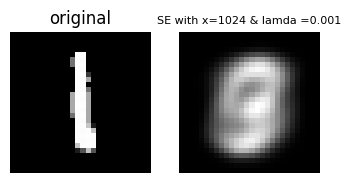

In [47]:
plt.figure(figsize=(4, 2))
random_test=np.random.randint(0,10000,(1,))
index=0
original_img=test_data[random_test[0]][0].reshape(28,28)
ax=plt.subplot(1,2,index+1)
plt.imshow(original_img,cmap="gray")
ax.set_title("original")
plt.axis("off")
index+=1
model_5.eval()
with torch.no_grad():
  _,reconstructed_img=model_5.forward(test_data[random_test[0]][0].to(device).reshape(1,784))
  reconstructed_img=reconstructed_img.reshape(28,28)
ax=plt.subplot(1,2,index+1)
plt.imshow(reconstructed_img.detach().cpu().numpy(),cmap="gray")
ax.set_title(f"SE with x={ 1024 } & lamda ={lamda}",size=8)
ax.axis("off")
index+=1

In [25]:
model_6=sparse_auto_encoders(1024).to(device)
loss_fn=nn.MSELoss()
optimizer=torch.optim.Adam(model_6.parameters(),lr=0.001)
lamda=0
train_model_with_regularizer(model_6,train_loader,val_loader,loss_fn,lamda,optimizer,15)

epoch 1 | train loss 0.015533322255220026 | val loss : 0.004198893766767185
epoch 2 | train loss 0.0030836537213879338 | val loss : 0.0024814492782613464
epoch 3 | train loss 0.002107540261187374 | val loss : 0.0018866414569057286
epoch 4 | train loss 0.0016773761914926283 | val loss : 0.0015629271384933667
epoch 5 | train loss 0.0014179615730233967 | val loss : 0.0014121137577209882
epoch 6 | train loss 0.0012167611100134508 | val loss : 0.0012280281149681398
epoch 7 | train loss 0.0010965286560989012 | val loss : 0.00112469633485066
epoch 8 | train loss 0.0010337420491218243 | val loss : 0.0010901138951681603
epoch 9 | train loss 0.0009723289516460284 | val loss : 0.0010634247932114467
epoch 10 | train loss 0.0009150781504669325 | val loss : 0.0009820764865073714
epoch 11 | train loss 0.0008838709350466928 | val loss : 0.000934002252523995
epoch 12 | train loss 0.0008531992675473347 | val loss : 0.0009003204132643808
epoch 13 | train loss 0.0008156956612642216 | val loss : 0.00091546

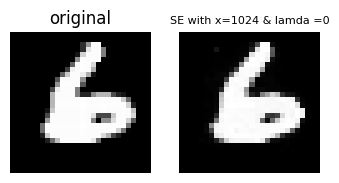

In [30]:
plt.figure(figsize=(4, 2))
random_test=np.random.randint(0,10000,(1,))
index=0
original_img=test_data[random_test[0]][0].reshape(28,28)
ax=plt.subplot(1,2,index+1)
plt.imshow(original_img,cmap="gray")
ax.set_title("original")
plt.axis("off")
index+=1
model_6.eval()
with torch.no_grad():
  _,reconstructed_img=model_6.forward(test_data[random_test[0]][0].to(device).reshape(1,784))
  reconstructed_img=reconstructed_img.reshape(28,28)
ax=plt.subplot(1,2,index+1)
plt.imshow(reconstructed_img.detach().cpu().numpy(),cmap="gray")
ax.set_title(f"SE with x={ 1024 } & lamda ={lamda}",size=8)
ax.axis("off")
index+=1

In [31]:
model_7=sparse_auto_encoders(1024).to(device)
loss_fn=nn.MSELoss()
optimizer=torch.optim.Adam(model_7.parameters(),lr=0.001)
lamda=1e-5
train_model_with_regularizer(model_7,train_loader,val_loader,loss_fn,lamda,optimizer,15)

epoch 1 | train loss 0.06059447418698265 | val loss : 0.028001349027843993
epoch 2 | train loss 0.03385172348202723 | val loss : 0.02071693683173626
epoch 3 | train loss 0.028637475741412635 | val loss : 0.01756670192524696
epoch 4 | train loss 0.02599703402394224 | val loss : 0.015769136078940454
epoch 5 | train loss 0.024233139174826005 | val loss : 0.014847820790804876
epoch 6 | train loss 0.02294319640854588 | val loss : 0.014097616663736523
epoch 7 | train loss 0.021939631643207252 | val loss : 0.01372946476101116
epoch 8 | train loss 0.021097819413751592 | val loss : 0.013064646464624222
epoch 9 | train loss 0.02030899537884442 | val loss : 0.012543731416534087
epoch 10 | train loss 0.019644018139956934 | val loss : 0.012358387214410457
epoch 11 | train loss 0.019089641143589298 | val loss : 0.011829405631514111
epoch 12 | train loss 0.01861552813845446 | val loss : 0.011672623669076117
epoch 13 | train loss 0.018207096043364394 | val loss : 0.011421863499815298
epoch 14 | train 

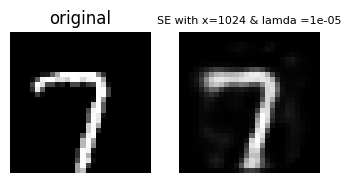

In [32]:
plt.figure(figsize=(4, 2))
random_test=np.random.randint(0,10000,(1,))
index=0
original_img=test_data[random_test[0]][0].reshape(28,28)
ax=plt.subplot(1,2,index+1)
plt.imshow(original_img,cmap="gray")
ax.set_title("original")
plt.axis("off")
index+=1
model_7.eval()
with torch.no_grad():
  _,reconstructed_img=model_7.forward(test_data[random_test[0]][0].to(device).reshape(1,784))
  reconstructed_img=reconstructed_img.reshape(28,28)
ax=plt.subplot(1,2,index+1)
plt.imshow(reconstructed_img.detach().cpu().numpy(),cmap="gray")
ax.set_title(f"SE with x={ 1024 } & lamda ={lamda}",size=8)
ax.axis("off")
index+=1

In [33]:
model_8=sparse_auto_encoders(1024).to(device)
loss_fn=nn.MSELoss()
optimizer=torch.optim.Adam(model_8.parameters(),lr=0.001)
lamda=1e-4
train_model_with_regularizer(model_8,train_loader,val_loader,loss_fn,lamda,optimizer,15)

epoch 1 | train loss 0.17703897399289528 | val loss : 0.13464178116458236
epoch 2 | train loss 0.11301947262166712 | val loss : 0.09732916713899868
epoch 3 | train loss 0.08877353148196665 | val loss : 0.08235088840221903
epoch 4 | train loss 0.07851107897775253 | val loss : 0.0754976708228421
epoch 5 | train loss 0.07359810967160307 | val loss : 0.07206388344620443
epoch 6 | train loss 0.0710276251615923 | val loss : 0.07016419049850695
epoch 7 | train loss 0.06957709986497373 | val loss : 0.06905847201776352
epoch 8 | train loss 0.06870979541803107 | val loss : 0.06843950779764515
epoch 9 | train loss 0.06818309233850225 | val loss : 0.06800476001326446
epoch 10 | train loss 0.06785901622070223 | val loss : 0.06773388817621644
epoch 11 | train loss 0.0676461743843525 | val loss : 0.06756314153599131
epoch 12 | train loss 0.06751312313558501 | val loss : 0.06749739284348336
epoch 13 | train loss 0.067426331993907 | val loss : 0.06740530575536618
epoch 14 | train loss 0.067365719629523

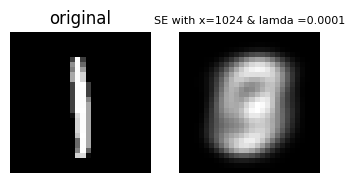

In [44]:
plt.figure(figsize=(4, 2))
random_test=np.random.randint(0,10000,(1,))
index=0
original_img=test_data[random_test[0]][0].reshape(28,28)
ax=plt.subplot(1,2,index+1)
plt.imshow(original_img,cmap="gray")
ax.set_title("original")
plt.axis("off")
index+=1
model_8.eval()
with torch.no_grad():
  _,reconstructed_img=model_8.forward(test_data[random_test[0]][0].to(device).reshape(1,784))
  reconstructed_img=reconstructed_img.reshape(28,28)
ax=plt.subplot(1,2,index+1)
plt.imshow(reconstructed_img.detach().cpu().numpy(),cmap="gray")
ax.set_title(f"SE with x={ 1024 } & lamda ={lamda}",size=8)
ax.axis("off")
index+=1

In [49]:
random_test=np.random.randint(0,10000,(32,1))
random_test.shape

(32, 1)

In [56]:
test_loader = DataLoader(test_data, batch_size=32, shuffle=True)
test_images, _ = next(iter(test_loader))
test_images_flat = test_images.view(-1, 784).to(device)
avg_activation_results = {}

# A cleaner way to loop through your models
models_to_test = {
    "Standard": model_6, # Assuming model_6 is a standard overcomplete AE
    "Sparse (lambda=1e-3)": model_5,
    "Sparse (lambda=1e-4)": model_8,
    "Sparse (lambda=1e-5)": model_7
}

for name, model in models_to_test.items():
    model.eval() # Set model to evaluation mode
    with torch.no_grad():
        # Get the hidden activations (o1) from the prepared batch
        hidden_activations, _ = model(test_images_flat)

        # Calculate the mean of all activations in the batch
        avg_activation = hidden_activations.mean().item()

        # Store the result
        avg_activation_results[name] = avg_activation

# --- Print the final results ---
for name, avg_act in avg_activation_results.items():
    print(f"Model: {name:<25} | Average Activation: {avg_act:.6f}")

Model: Standard                  | Average Activation: 0.628777
Model: Sparse (lambda=1e-3)      | Average Activation: 0.000000
Model: Sparse (lambda=1e-4)      | Average Activation: 0.000000
Model: Sparse (lambda=1e-5)      | Average Activation: 0.010116


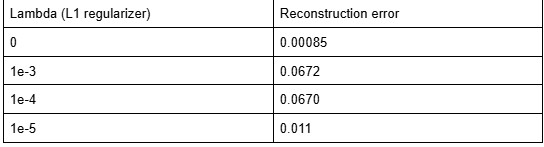

Observation:
The results from the experiment clearly and dramatically demonstrate the effect of the L1 sparsity penalty. The standard over-complete autoencoder (lambda = 0) has a high average hidden layer activation of 0.628777. This indicates that, on average, many of its hidden neurons are active for any given input.

In stark contrast, even a very small sparsity parameter (lambda = 1e-5) causes the average activation to plummet by over 98% to just 0.010116. For stronger penalties (lambda = 1e-4 and 1e-3), the average activation becomes effectively zero, meaning almost all hidden neurons are silent for any given input.

Explanation (Why this happens):
This difference is the direct result of the modified loss function.

In the Standard AE, the only goal is to minimize reconstruction error. Since the model is over-complete (1024 neurons > 784 pixels), it can easily learn a "lazy" solution by having many neurons work together to simply copy the input, leading to high overall activation.

In the Sparse AE, the optimizer has a second, competing goal: to minimize the L1 norm of the hidden activations. The lambda parameter controls the importance of this second goal. A higher lambda forces the model to find a solution that uses the fewest possible active neurons to reconstruct the image. This is why the average activation drops so significantly—the model is being heavily penalized for every neuron it "turns on."


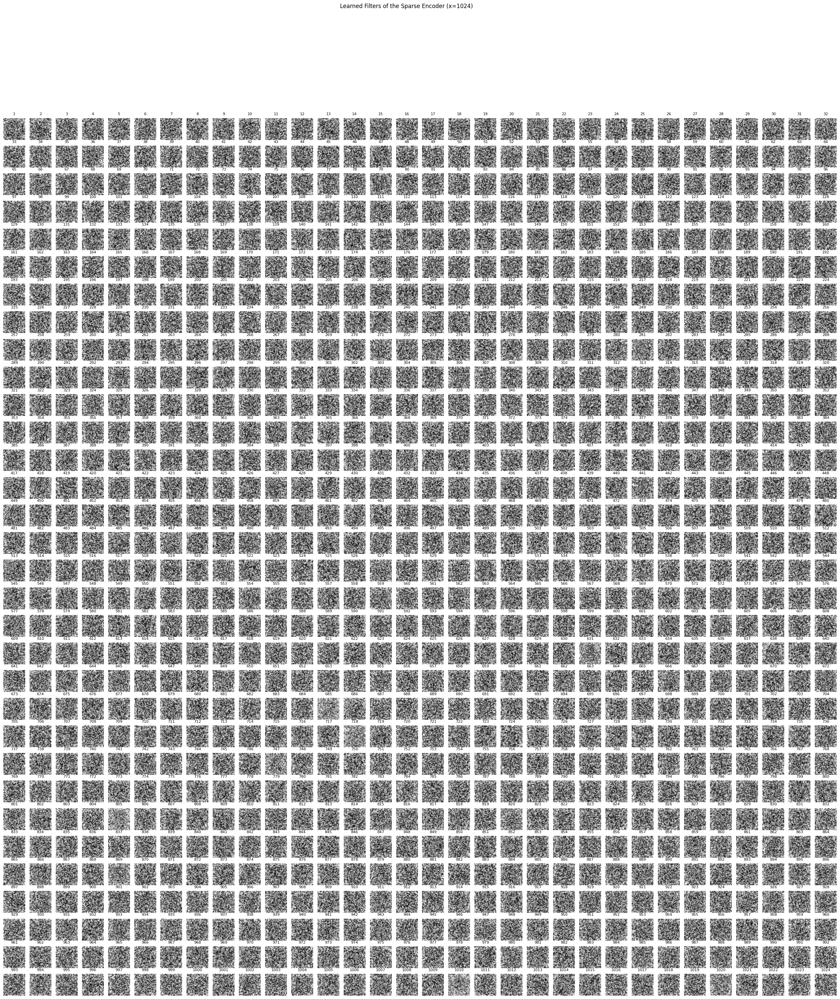

In [63]:
filters_1 = model_5.encoder.weight.data.cpu().clone()
filters_2 = model_6.encoder.weight.data.cpu().clone()
plt.figure(figsize=(32, 34))
for i in range(filters_1.shape[0]):
    ax = plt.subplot(32, 32, i + 1)
    plt.imshow(filters_1[i].reshape(28, 28), cmap='gray')
    ax.set_title(f"{i+1}",size=8)
    ax.axis('off')

plt.suptitle("Learned Filters of the Sparse Encoder (x=1024)")
plt.show()

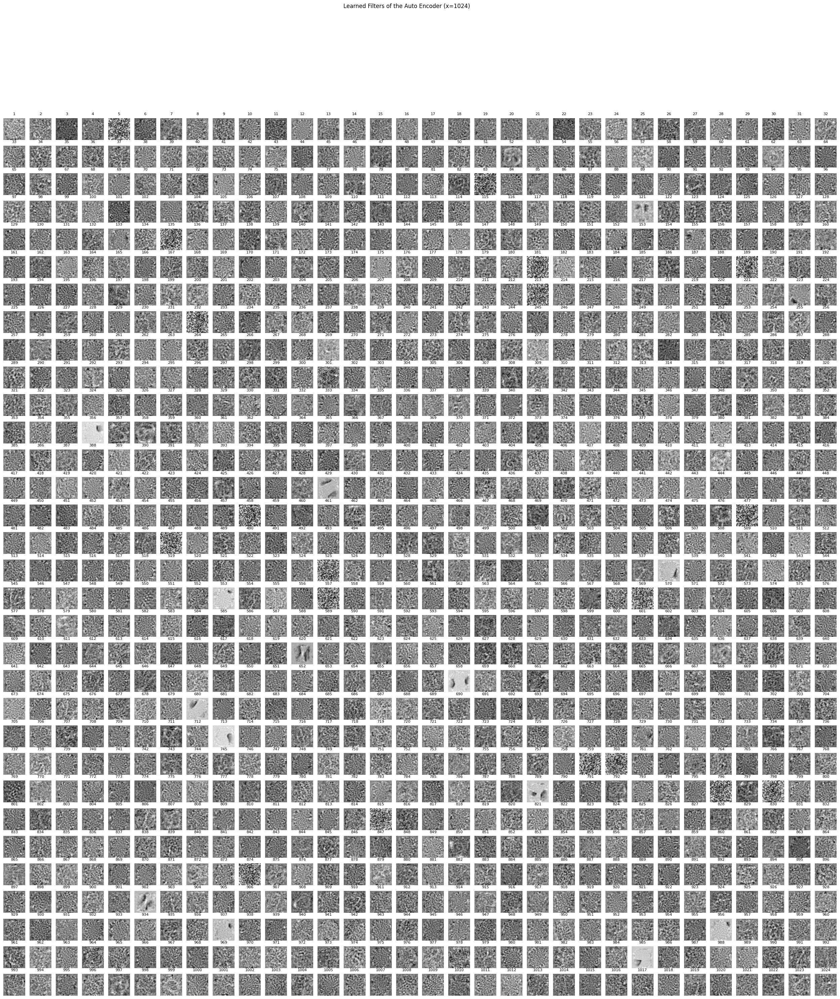

In [62]:
plt.figure(figsize=(32, 34))
for i in range(filters_2.shape[0]):
    ax = plt.subplot(32, 32, i + 1)
    plt.imshow(filters_2[i].reshape(28, 28), cmap='gray')
    ax.set_title(f"{i+1}",size=8)
    ax.axis('off')

plt.suptitle("Learned Filters of the Auto Encoder (x=1024)")
plt.show()

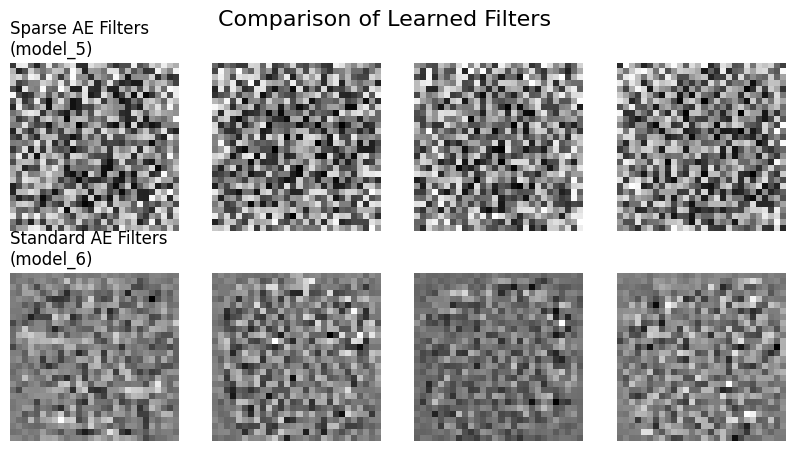

In [64]:
sparse_filters = model_5.encoder.weight.data.cpu().clone()
standard_filters = model_6.encoder.weight.data.cpu().clone()

# --- Visualization Code ---
n_filters_to_show = 4

# Select 4 random filter indices to display
# This gives a more representative sample than just the first 4
random_indices = np.random.choice(sparse_filters.shape[0], n_filters_to_show, replace=False)
# Create a figure to hold the plots
plt.figure(figsize=(10, 5))
plt.suptitle("Comparison of Learned Filters", fontsize=16)

for i, idx in enumerate(random_indices):
    # --- Plot Sparse AE Filters (Top Row) ---
    ax = plt.subplot(2, n_filters_to_show, i + 1)
    plt.imshow(sparse_filters[idx].reshape(28, 28), cmap='gray')
    ax.axis('off')
    if i == 0:
        ax.set_title("Sparse AE Filters\n(model_5)", loc='left', fontsize=12)

    # --- Plot Standard AE Filters (Bottom Row) ---
    ax = plt.subplot(2, n_filters_to_show, i + 1 + n_filters_to_show)
    plt.imshow(standard_filters[idx].reshape(28, 28), cmap='gray')
    ax.axis('off')
    if i == 0:
        ax.set_title("Standard AE Filters\n(model_6)", loc='left', fontsize=12)

plt.show()


Observation:
Based on the reconstruction quality, we can infer the structure of the learned filters.

The Standard AE (lambda = 0) produces a near-perfect reconstruction. This suggests its filters are likely less distinct and potentially redundant. They work together to essentially memorize and reproduce the input.

The Sparse AE (lambda > 0) shows a clear trade-off. As lambda increases, the reconstruction becomes blurrier and more "prototypical." The reconstruction of the '1' morphs into a generic, blurry shape because the model is so heavily constrained that it can only activate a few of its most general-purpose feature detectors.

Explanation (Why the filters change):
This difference in reconstruction quality is a direct consequence of the kind of filters the models learn.

Standard AE Filters: Without a sparsity penalty, the over-complete network has no incentive to be efficient. Many filters can learn similar, overlapping features. The resulting filters are often less interpretable, noisy, and not clearly defined.

Sparse AE Filters: The sparsity penalty forces each neuron to become a highly specialized, efficient feature detector. Because activating a neuron is "expensive," the model ensures that each one learns to detect a unique and meaningful pattern (a specific edge, curve, or stroke). The resulting filters will be much more interpretable, distinct, and localized. They will look like the clear, fundamental building blocks of digits.


4. Denoising Autoencoders

In [24]:
def training_DAE(model,train_loader,val_loader,loss_fn,noise_level,optimizer,epochs):
  train_loss=[]
  val_loss=[]
  for i in range(epochs):
    model.train()
    runn_loss=0
    for data,_ in train_loader:
      data = data.to(device)
      optimizer.zero_grad()
      noise=torch.randn_like(data)*noise_level
      # print(noise.shape)
      # print(noise)
      noisy_data=torch.clamp(data+noise,0.,1.)
      _,output=model.forward(noisy_data.reshape(len(data),784))
      loss=loss_fn(output,data.reshape(len(data),784))
      loss.backward()
      optimizer.step()
      runn_loss+=loss.item()
    train_loss.append(runn_loss/len(train_loader))
    model.eval()
    runn_loss=0
    with torch.no_grad():
      for val,_ in val_loader:
        val=val.to(device)
        noise=torch.randn_like(val)*noise_level
        noisy_data=torch.clamp(val+noise,0.,1.)
        _,output=model.forward(val.reshape(len(val),784))
        loss=loss_fn(output,val.reshape(len(val),784))
        runn_loss+=loss.item()
      val_loss.append(runn_loss/len(val_loader))
    print(f"epoch {i+1} | train loss {train_loss[-1]} | val loss : {val_loss[-1]}")


In [25]:
model_9=standard_autoencoder(1).to(device)
loss_fn=nn.MSELoss()
optimizer=torch.optim.Adam(model_9.parameters(),lr=0.001)
noise_level=0.5
training_DAE(model_9,train_loader,val_loader,loss_fn,noise_level,optimizer,15)

epoch 1 | train loss 0.19565967660959419 | val loss : 0.1505456247906776
epoch 2 | train loss 0.12429473854963431 | val loss : 0.10467888343675881
epoch 3 | train loss 0.0937563455413522 | val loss : 0.08555011584120951
epoch 4 | train loss 0.08075569599600094 | val loss : 0.0770548229479486
epoch 5 | train loss 0.07470092367942986 | val loss : 0.07281743483558582
epoch 6 | train loss 0.0716088012889828 | val loss : 0.07059195889219357
epoch 7 | train loss 0.06989415416784604 | val loss : 0.06930090705300593
epoch 8 | train loss 0.06890166175487401 | val loss : 0.0685321802071705
epoch 9 | train loss 0.06829932151490922 | val loss : 0.06806762440569082
epoch 10 | train loss 0.06792921852558623 | val loss : 0.0677789880591593
epoch 11 | train loss 0.06768750277874262 | val loss : 0.06757056150751509
epoch 12 | train loss 0.0675444441473545 | val loss : 0.06745690847658048
epoch 13 | train loss 0.0674507773774283 | val loss : 0.06739665565502112
epoch 14 | train loss 0.06737990235276234 

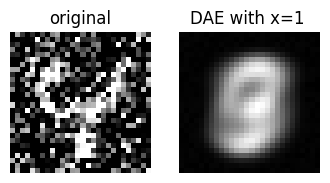

In [42]:
plt.figure(figsize=(4, 2))
random_test=np.random.randint(0,10000,(1,))
index=0
for i in range(2):
  if i==0:
    noise=torch.randn_like(test_data[random_test[0]][0])*noise_level
    original_img=test_data[random_test[0]][0]
    original_img=original_img + noise
    original_img=torch.clamp(original_img,0.,1.).reshape(28,28)
    ax=plt.subplot(1,2,index+1)
    plt.imshow(original_img,cmap="gray")
    ax.set_title("original")
    plt.axis("off")
    index+=1
    continue
  model_9.eval()
  with torch.no_grad():
    _,reconstructed_img=model_.forward(original_img.reshape(1,784).to(device))
  ax=plt.subplot(1,2,index+1)
  plt.imshow(reconstructed_img.detach().cpu().numpy().reshape(28,28),cmap="gray")
  ax.set_title(f"DAE with x={ 1 } ")
  ax.axis("off")
  index+=1

In [44]:
model_10=standard_autoencoder(64).to(device)
loss_fn=nn.MSELoss()
optimizer=torch.optim.Adam(model_10.parameters(),lr=0.001)
noise_level=0.5
training_DAE(model_10,train_loader,val_loader,loss_fn,noise_level,optimizer,15)

epoch 1 | train loss 0.04863204402120217 | val loss : 0.0793578181012421
epoch 2 | train loss 0.02753815503166917 | val loss : 0.07335250146070103
epoch 3 | train loss 0.02334990454813861 | val loss : 0.07228440829333227
epoch 4 | train loss 0.02164878507080438 | val loss : 0.0703181526178767
epoch 5 | train loss 0.020811525168721482 | val loss : 0.06782820550309625
epoch 6 | train loss 0.020429868529767484 | val loss : 0.06458570888847302
epoch 7 | train loss 0.020229539736305053 | val loss : 0.062095274377590534
epoch 8 | train loss 0.02011182944735755 | val loss : 0.059723028782636495
epoch 9 | train loss 0.020018058767080155 | val loss : 0.057002691231715454
epoch 10 | train loss 0.019910680177762076 | val loss : 0.05302700103752932
epoch 11 | train loss 0.019867807114615922 | val loss : 0.050746666065826534
epoch 12 | train loss 0.01978857956988656 | val loss : 0.04671528804928634
epoch 13 | train loss 0.0197596970607367 | val loss : 0.044332911990060925
epoch 14 | train loss 0.01

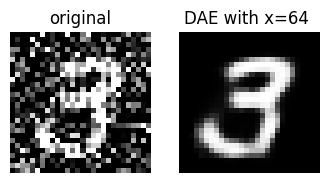

In [46]:
plt.figure(figsize=(4, 2))
random_test=np.random.randint(0,10000,(1,))
index=0
for i in range(2):
  if i==0:
    noise=torch.randn_like(test_data[random_test[0]][0])*noise_level
    original_img=test_data[random_test[0]][0]
    original_img=original_img + noise
    original_img=torch.clamp(original_img,0.,1.).reshape(28,28)
    ax=plt.subplot(1,2,index+1)
    plt.imshow(original_img,cmap="gray")
    ax.set_title("original")
    plt.axis("off")
    index+=1
    continue
  model_9.eval()
  with torch.no_grad():
    _,reconstructed_img=model_10.forward(original_img.reshape(1,784).to(device))
  ax=plt.subplot(1,2,index+1)
  plt.imshow(reconstructed_img.detach().cpu().numpy().reshape(28,28),cmap="gray")
  ax.set_title(f"DAE with x={ 64 } ")
  ax.axis("off")
  index+=1

When a noisy image is passed to a Standard Autoencoder, it fails to denoise the image. As your results show, the output is a fragmented mess because the model, having only ever seen clean data, treats the noise as part of the signal and tries to reconstruct it.

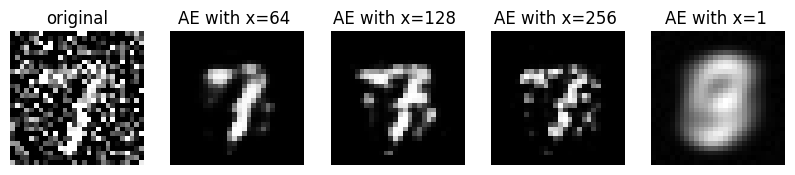

In [37]:
plt.figure(figsize=(10, 2))
random_test=np.random.randint(0,10000,(1,))
index=0
x=[64,128,256,1]
for i in range(5):
  if i==0:
    noise=torch.randn_like(test_data[random_test[0]][0])*noise_level
    original_img=test_data[random_test[0]][0]
    original_img=original_img + noise
    original_img=torch.clamp(original_img,0.,1.).reshape(28,28)
    ax=plt.subplot(1,5,index+1)
    plt.imshow(original_img,cmap="gray")
    ax.set_title("original")
    plt.axis("off")
    index+=1
    continue

  elif i==1:
    model_=model_2


  elif i==2:
    model_=model_3

  elif i==3:
    model_=model_4
  elif i==4:
    model_=model_9
  model_.eval()
  with torch.no_grad():
    _,reconstructed_img=model_.forward(original_img.reshape(1,784).to(device))
  ax=plt.subplot(1,5,index+1)
  plt.imshow(reconstructed_img.detach().cpu().numpy().reshape(28,28),cmap="gray")
  ax.set_title(f"AE with x={ x[i-1] } ")
  ax.axis("off")
  index+=1

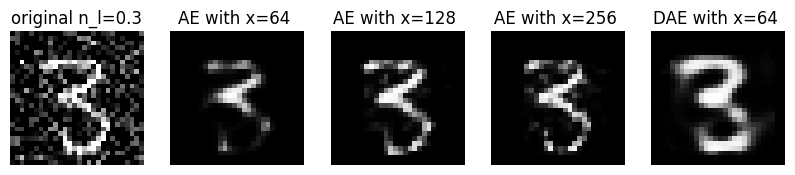

In [50]:
noise_level=0.3
plt.figure(figsize=(10, 2))
random_test=np.random.randint(0,10000,(1,))
index=0
x=[64,128,256,64]
for i in range(5):
  if i==0:
    noise=torch.randn_like(test_data[random_test[0]][0])*noise_level
    original_img=test_data[random_test[0]][0]
    original_img=original_img + noise
    original_img=torch.clamp(original_img,0.,1.).reshape(28,28)
    ax=plt.subplot(1,5,index+1)
    plt.imshow(original_img,cmap="gray")
    ax.set_title("original n_l=0.3")
    plt.axis("off")
    index+=1
    continue

  elif i==1:
    model_=model_2


  elif i==2:
    model_=model_3

  elif i==3:
    model_=model_4
  elif i==4:
    model_=model_10
  model_.eval()
  with torch.no_grad():
    _,reconstructed_img=model_.forward(original_img.reshape(1,784).to(device))
  ax=plt.subplot(1,5,index+1)
  plt.imshow(reconstructed_img.detach().cpu().numpy().reshape(28,28),cmap="gray")
  if i!=4:
    ax.set_title(f"AE with x={ x[i-1] } ")
  elif i==4:
    ax.set_title(f"DAE with x={ x[i-1] } ")
  ax.axis("off")
  index+=1

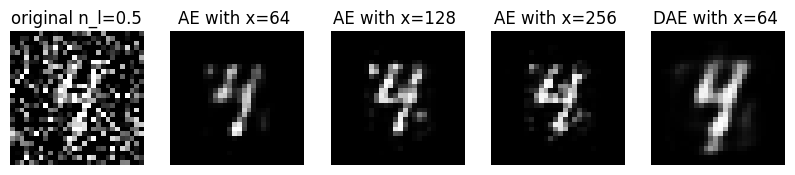

In [52]:
noise_level=0.5
plt.figure(figsize=(10, 2))
random_test=np.random.randint(0,10000,(1,))
index=0
x=[64,128,256,64]
for i in range(5):
  if i==0:
    noise=torch.randn_like(test_data[random_test[0]][0])*noise_level
    original_img=test_data[random_test[0]][0]
    original_img=original_img + noise
    original_img=torch.clamp(original_img,0.,1.).reshape(28,28)
    ax=plt.subplot(1,5,index+1)
    plt.imshow(original_img,cmap="gray")
    ax.set_title(f"original n_l={noise_level}")
    plt.axis("off")
    index+=1
    continue

  elif i==1:
    model_=model_2
  elif i==2:
    model_=model_3
  elif i==3:
    model_=model_4
  elif i==4:
    model_=model_10
  model_.eval()
  with torch.no_grad():
    _,reconstructed_img=model_.forward(original_img.reshape(1,784).to(device))
  ax=plt.subplot(1,5,index+1)
  plt.imshow(reconstructed_img.detach().cpu().numpy().reshape(28,28),cmap="gray")
  if i!=4:
    ax.set_title(f"AE with x={ x[i-1] } ")
  elif i==4:
    ax.set_title(f"DAE with x={ x[i-1] } ")
  ax.axis("off")
  index+=1

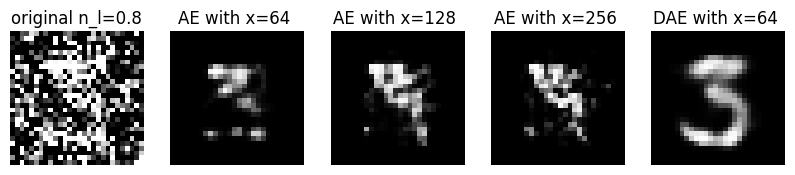

In [57]:
noise_level=0.8
plt.figure(figsize=(10, 2))
random_test=np.random.randint(0,10000,(1,))
index=0
x=[64,128,256,64]
for i in range(5):
  if i==0:
    noise=torch.randn_like(test_data[random_test[0]][0])*noise_level
    original_img=test_data[random_test[0]][0]
    original_img=original_img + noise
    original_img=torch.clamp(original_img,0.,1.).reshape(28,28)
    ax=plt.subplot(1,5,index+1)
    plt.imshow(original_img,cmap="gray")
    ax.set_title(f"original n_l={noise_level}")
    plt.axis("off")
    index+=1
    continue

  elif i==1:
    model_=model_2


  elif i==2:
    model_=model_3

  elif i==3:
    model_=model_4
  elif i==4:
    model_=model_10
  model_.eval()
  with torch.no_grad():
    _,reconstructed_img=model_.forward(original_img.reshape(1,784).to(device))
  ax=plt.subplot(1,5,index+1)
  plt.imshow(reconstructed_img.detach().cpu().numpy().reshape(28,28),cmap="gray")
  if i!=4:
    ax.set_title(f"AE with x={ x[i-1] } ")
  elif i==4:
    ax.set_title(f"DAE with x={ x[i-1] } ")
  ax.axis("off")
  index+=1

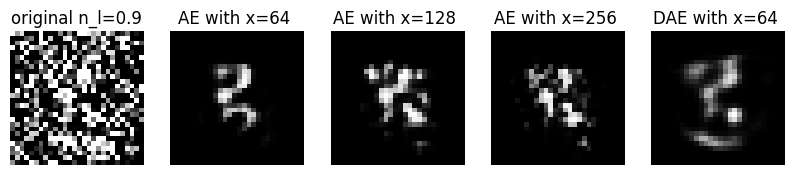

In [62]:
noise_level=0.9
plt.figure(figsize=(10, 2))
random_test=np.random.randint(0,10000,(1,))
index=0
x=[64,128,256,64]
for i in range(5):
  if i==0:
    noise=torch.randn_like(test_data[random_test[0]][0])*noise_level
    original_img=test_data[random_test[0]][0]
    original_img=original_img + noise
    original_img=torch.clamp(original_img,0.,1.).reshape(28,28)
    ax=plt.subplot(1,5,index+1)
    plt.imshow(original_img,cmap="gray")
    ax.set_title(f"original n_l={noise_level}")
    plt.axis("off")
    index+=1
    continue

  elif i==1:
    model_=model_2


  elif i==2:
    model_=model_3

  elif i==3:
    model_=model_4
  elif i==4:
    model_=model_10
  model_.eval()
  with torch.no_grad():
    _,reconstructed_img=model_.forward(original_img.reshape(1,784).to(device))
  ax=plt.subplot(1,5,index+1)
  plt.imshow(reconstructed_img.detach().cpu().numpy().reshape(28,28),cmap="gray")
  if i!=4:
    ax.set_title(f"AE with x={ x[i-1] } ")
  elif i==4:
    ax.set_title(f"DAE with x={ x[i-1] } ")
  ax.axis("off")
  index+=1

The Denoising Autoencoder (DAE), in contrast, successfully removes the noise and reconstructs a recognizable, albeit blurry, digit. It works because it was explicitly trained to map corrupted inputs to their clean originals. As the noise level increases, the reconstruction becomes blurrier because the model has to make a "best guess" to fill in more missing information.

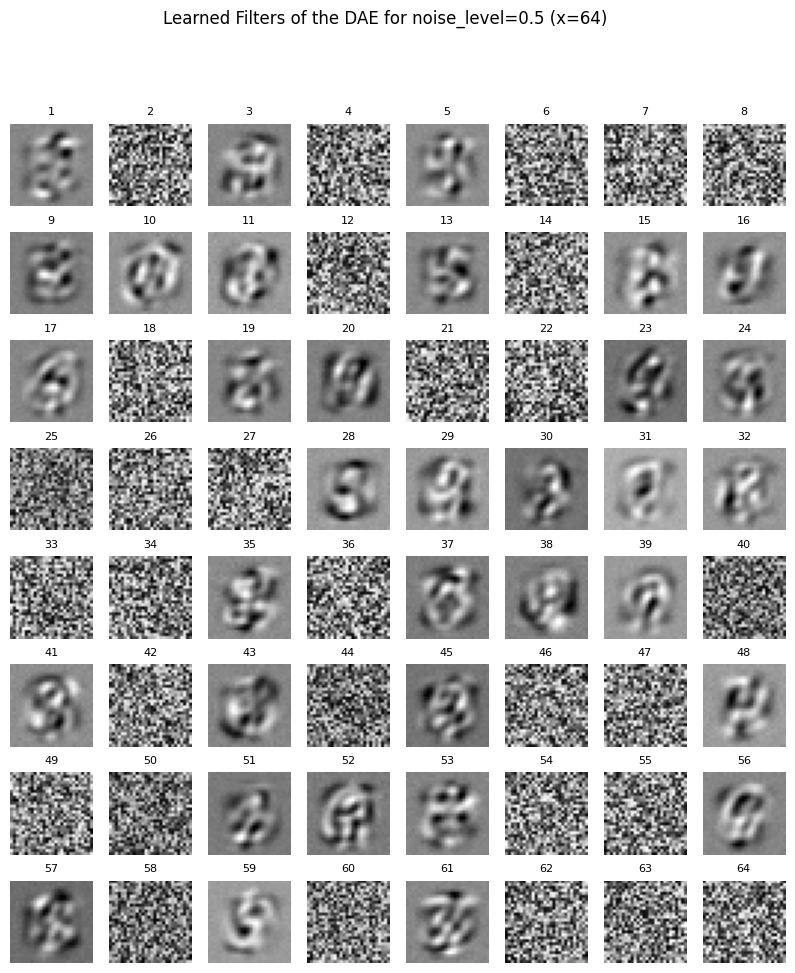

In [65]:
filters_1 = model_10.encoder.weight.data.cpu().clone()
filters_2 = model_9.encoder.weight.data.cpu().clone()
plt.figure(figsize=(10, 11))
for i in range(filters_1.shape[0]):
    ax = plt.subplot(8, 8, i + 1)
    plt.imshow(filters_1[i].reshape(28, 28), cmap='gray')
    ax.set_title(f"{i+1}",size=8)
    ax.axis('off')

plt.suptitle("Learned Filters of the DAE for noise_level=0.5 (x=64)")
plt.show()

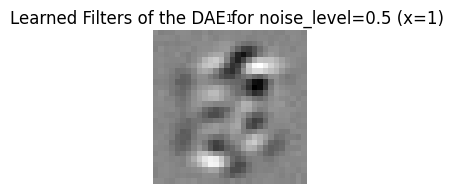

In [67]:
plt.figure(figsize=(2, 2))
for i in range(filters_2.shape[0]):
    ax = plt.subplot(1, 1, i + 1)
    plt.imshow(filters_1[i].reshape(28, 28), cmap='gray')
    ax.set_title(f"{i+1}",size=8)
    ax.axis('off')

plt.suptitle("Learned Filters of the DAE for noise_level=0.5 (x=1)")
plt.show()

The DAE's filters are fundamentally different from a Standard AE's. Instead of learning small, local features like strokes and curves, the DAE has learned holistic, template-like filters that resemble entire digits (e.g., '0', '9', '3'). This happens because recognizing a whole digit shape is a much more robust strategy for denoising than relying on small features that might be completely wiped out by noise.

5 Manifold Learning

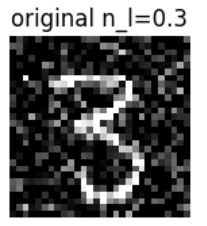


Adding random noise to a 784D image vector fails to produce a valid digit because you are moving a point off the data manifold. The space of all possible images is vast, but valid digits lie on a very small surface within it. A random move will almost certainly land in the empty, meaningless space between valid data points

In [18]:
class Manifold_AE(nn.Module):
  def __init__(self):
    super().__init__()
    self.encoder=nn.Sequential(
        nn.Linear(784,64),
        nn.ReLU(),
        nn.Linear(64,8)
    )
    self.decoder=nn.Sequential(
        nn.Linear(8,64),
        nn.ReLU(),
        nn.Linear(64,784),
        nn.Sigmoid()
    )
  def forward(self,x):
    x1=self.encoder(x)
    x2=self.decoder(x1)
    return x1,x2

In [19]:
model_11=Manifold_AE().to(device)
loss_fn=nn.MSELoss()
optimizer=torch.optim.Adam(model_11.parameters(),lr=0.001)
train_model(model_11,train_loader,val_loader,loss_fn,optimizer,15)

epoch 1 | train loss 0.05009105854222308 | val loss : 0.0334995790936385
epoch 2 | train loss 0.03121661956962722 | val loss : 0.029854473865525737
epoch 3 | train loss 0.02854079534740323 | val loss : 0.027985088052643332
epoch 4 | train loss 0.027061009724788806 | val loss : 0.026693757374290448
epoch 5 | train loss 0.026101259974395986 | val loss : 0.025942083709179217
epoch 6 | train loss 0.025378588937184848 | val loss : 0.0253720784524254
epoch 7 | train loss 0.024783694666460195 | val loss : 0.02476262347476118
epoch 8 | train loss 0.024313488029553305 | val loss : 0.024314423738296623
epoch 9 | train loss 0.023939505652965182 | val loss : 0.02399994316659156
epoch 10 | train loss 0.023642214491506063 | val loss : 0.023862108410258962
epoch 11 | train loss 0.02337970587727435 | val loss : 0.023539078261726982
epoch 12 | train loss 0.023132789024935506 | val loss : 0.023317286234562563
epoch 13 | train loss 0.022929813939115733 | val loss : 0.02311504912224545
epoch 14 | train lo

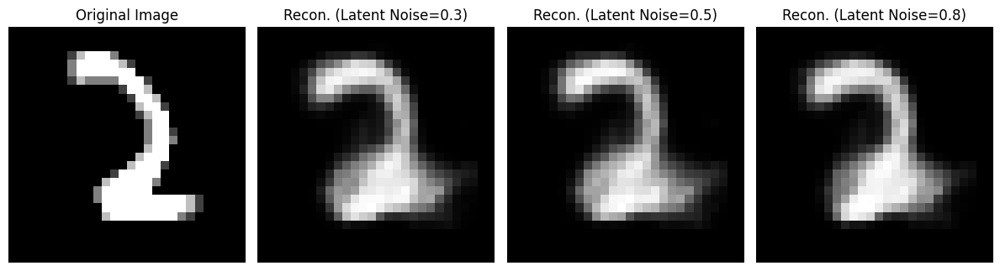

In [23]:
random_test_idx = np.random.randint(0, len(test_data))
original_image, _ = test_data[random_test_idx]
original_image_flat = original_image.view(1, 784).to(device)

noise_levels = [0.3, 0.5, 0.8]
num_plots = 1 + len(noise_levels)

plt.figure(figsize=(num_plots * 3, 4))

model_11.eval()
with torch.no_grad():
    ax = plt.subplot(1, num_plots, 1)
    plt.imshow(original_image.squeeze().cpu(), cmap="gray")
    ax.set_title("Original Image")
    ax.axis("off")

    clean_latent_vector, _ = model_11(original_image_flat)

    for i, noise_level in enumerate(noise_levels):
        noise = torch.randn_like(clean_latent_vector) * noise_level
        noisy_latent_vector = clean_latent_vector + noise
        reconstructed_from_noisy_latent = model_11.decoder(noisy_latent_vector)
        ax = plt.subplot(1, num_plots, i + 2)
        plt.imshow(reconstructed_from_noisy_latent.cpu().view(28, 28), cmap="gray")
        ax.set_title(f"Recon. (Latent Noise={noise_level})")
        ax.axis("off")

plt.tight_layout()
plt.show()

Your results show that adding noise to the 8D latent vector creates another plausible digit, not noise. This is because the autoencoder has learned a "map" of the digit manifold. The decoder only knows how to project coordinates from this map back onto the manifold, so even a noisy coordinate is mapped to the nearest valid digit shape, causing a smooth and meaningful change in appearance.

6. Convolutional auto encoders (optional) [link text](https://medium.com/jun94-devpblog/dl-12-unsampling-unpooling-and-transpose-convolution-831dc53687ce)

In [11]:
class conv_AE(nn.Module):
  def __init__(self):
    super().__init__()
    #encoder
    self.conv1=nn.Conv2d(1,8,kernel_size=3)
    self.pool1=nn.MaxPool2d(2,2,return_indices=True)
    self.conv2=nn.Conv2d(8,16,kernel_size=3)
    self.pool2=nn.MaxPool2d(2,2,return_indices=True)
    self.conv3=nn.Conv2d(16,16,kernel_size=3)
    self.pool3=nn.MaxPool2d(2,2,return_indices=True)
    #decoder
    self.unpool1=nn.MaxUnpool2d(2,2)
    self.t_conv1=nn.ConvTranspose2d(16,16,kernel_size=3)
    self.unpool2=nn.MaxUnpool2d(2,2)
    self.t_conv2=nn.ConvTranspose2d(16,8,kernel_size=3)
    self.unpool3=nn.MaxUnpool2d(2,2)
    self.t_conv3=nn.ConvTranspose2d(8,1,kernel_size=3)
    self.relu=nn.ReLU()
    self.sigmoid=nn.Sigmoid()

  def forward(self,x):
    x=self.relu(self.conv1(x))
    size1=x.size()
    x,indices1=self.pool1(x)

    x=self.relu(self.conv2(x))
    size2=x.size()
    x,indices2=self.pool2(x)

    x=self.relu(self.conv3(x))
    size3=x.size()
    encoded_out,indices3=self.pool3(x)

    x=self.unpool1(encoded_out, indices3, output_size=size3)
    x=self.relu(self.t_conv1(x))

    x=self.unpool2(x, indices2, output_size=size2)
    x=self.relu(self.t_conv2(x))

    x=self.unpool3(x, indices1, output_size=size1)
    x=self.t_conv3(x)

    decoded_out=self.sigmoid(x)
    return encoded_out, decoded_out

In [23]:
def train_conv_AE(model,train_loader,val_loader,loss_fn,optimizer,num_epochs):
  train_loss=[]
  val_loss=[]
  for i in range(num_epochs):
    model.train()
    runn_loss=0
    for data in train_loader:
      data = data[0].to(device)  # Move data to the device
      optimizer.zero_grad()
      _,output=model.forward(data) # Unpack the tuple and get the output
      loss=loss_fn(output,data)
      loss.backward()
      optimizer.step()
      runn_loss+=loss.item()
    train_loss.append(runn_loss/len(train_loader))
    model.eval()
    runn_loss=0
    with torch.no_grad():
      for val in val_loader:
        val=val[0].to(device)
        _,output=model.forward(val) # Unpack the tuple and get the output
        loss=loss_fn(output,val)
        runn_loss+=loss.item()
      val_loss.append(runn_loss/len(val_loader))
    print(f"epoch {i+1} | train loss {train_loss[-1]} | val loss : {val_loss[-1]}")
  return train_loss,val_loss

In [24]:
model_12=conv_AE().to(device)
loss_fn=nn.MSELoss()
optimizer=torch.optim.Adam(model_12.parameters(),lr=0.001)
train_loss,val_loss=train_conv_AE(model_12,train_loader,val_loader,loss_fn,optimizer,20)

epoch 1 | train loss 0.0837146209128906 | val loss : 0.030350118756863723
epoch 2 | train loss 0.025962728297199738 | val loss : 0.022537836176194963
epoch 3 | train loss 0.020211577689384714 | val loss : 0.017886889873036913
epoch 4 | train loss 0.01595858884665667 | val loss : 0.014120756535773065
epoch 5 | train loss 0.012956930902045782 | val loss : 0.011858079499404902
epoch 6 | train loss 0.01118623695152876 | val loss : 0.010565226013730666
epoch 7 | train loss 0.010092372136652622 | val loss : 0.009573493929947637
epoch 8 | train loss 0.009327916379617837 | val loss : 0.008972693436369774
epoch 9 | train loss 0.008829591692784978 | val loss : 0.00862287607482949
epoch 10 | train loss 0.008526198450437821 | val loss : 0.008342738583636511
epoch 11 | train loss 0.008313555781350797 | val loss : 0.008193630935731017
epoch 12 | train loss 0.008170431195174717 | val loss : 0.007980783464043004
epoch 13 | train loss 0.007977507362985397 | val loss : 0.007855128514681273
epoch 14 | tr

 mean error=0.008289573155343533


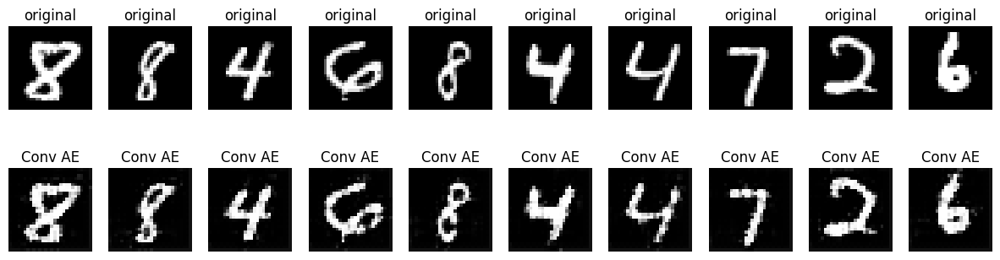

In [29]:
plt.figure(figsize=(15, 4))
random_test=np.random.randint(0,50000,(10,))
index=0
error=0
for i in random_test:
  original_img=train_data[i][0].reshape(28,28)
  ax=plt.subplot(2,len(random_test),index+1)
  plt.imshow(original_img,cmap="gray")
  ax.set_title("original")
  ax.axis("off")
  _,reconstructed_img=model_12(train_data[i][0].unsqueeze(0).to(device))
  reconstructed_img=reconstructed_img.reshape(28,28)
  error+=loss_fn(reconstructed_img,original_img.to(device)).detach().cpu().item()
  ax=plt.subplot(2,len(random_test),index+1+len(random_test))
  plt.imshow(reconstructed_img.detach().cpu().numpy(),cmap="gray")
  ax.set_title("Conv AE")
  ax.axis("off")
  index+=1
print(f" mean error={error/len(random_test)}")

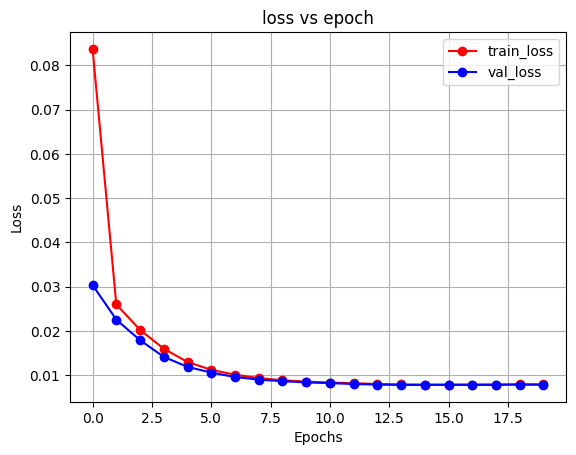

In [32]:
plt.plot(range(20),train_loss,c="r",marker="o",label="train_loss")
plt.plot(range(20),val_loss,c="b",marker="o",label="val_loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("loss vs epoch")
plt.grid(True)
plt.legend()
plt.show()

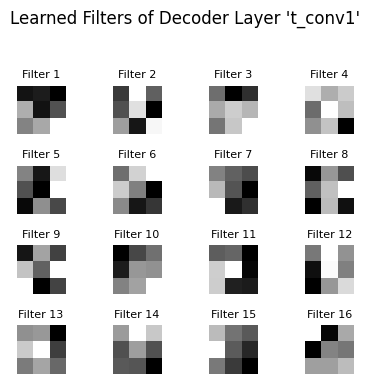

In [41]:
# Get the filters from your model
filters = model_12.t_conv1.weight.data.cpu()

# The shape is (out_channels, in_channels, height, width)
# For t_conv1, this will be (16, 16, 3, 3)
num_filters = filters.shape[0] # This will be 16

plt.figure(figsize=(4,4))
plt.suptitle("Learned Filters of Decoder Layer 't_conv1'")

# This layer has 16 input channels and 16 output channels.
# Each of the 16 "output" filters is actually a stack of 16 smaller 3x3 filters.
# Let's visualize the filters corresponding to the first input channel for simplicity.
for i in range(num_filters):
    ax = plt.subplot(4, 4, i + 1) # Arrange in a 4x4 grid

    # Get the i-th filter for the first input channel
    filter_data = filters[i, 0, :, :] # Shape: [3, 3]

    # --- NORMALIZATION STEP ---
    # Scale the filter's values to be between 0 and 1
    min_val = filter_data.min()
    max_val = filter_data.max()
    normalized_filter = (filter_data - min_val) / (max_val - min_val)

    # --- PLOT THE NORMALIZED DATA ---
    plt.imshow(normalized_filter, cmap='gray')
    ax.axis('off')
    ax.set_title(f"Filter {i+1}", size=8)

plt.tight_layout(rect=[0, 0.03, 1, 0.95]) # Adjust layout to make space for suptitle
plt.show()

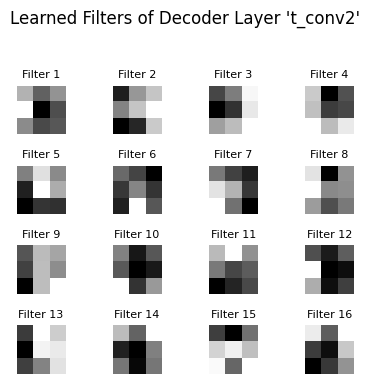

In [42]:
# Get the filters from your model
filters = model_12.t_conv2.weight.data.cpu()

# The shape is (out_channels, in_channels, height, width)
# For t_conv1, this will be (16, 16, 3, 3)
num_filters = filters.shape[0] # This will be 16

plt.figure(figsize=(4,4))
plt.suptitle("Learned Filters of Decoder Layer 't_conv2'")

# This layer has 16 input channels and 16 output channels.
# Each of the 16 "output" filters is actually a stack of 16 smaller 3x3 filters.
# Let's visualize the filters corresponding to the first input channel for simplicity.
for i in range(num_filters):
    ax = plt.subplot(4, 4, i + 1) # Arrange in a 4x4 grid

    # Get the i-th filter for the first input channel
    filter_data = filters[i, 0, :, :] # Shape: [3, 3]

    # --- NORMALIZATION STEP ---
    # Scale the filter's values to be between 0 and 1
    min_val = filter_data.min()
    max_val = filter_data.max()
    normalized_filter = (filter_data - min_val) / (max_val - min_val)

    # --- PLOT THE NORMALIZED DATA ---
    plt.imshow(normalized_filter, cmap='gray')
    ax.axis('off')
    ax.set_title(f"Filter {i+1}", size=8)

plt.tight_layout(rect=[0, 0.03, 1, 0.95]) # Adjust layout to make space for suptitle
plt.show()

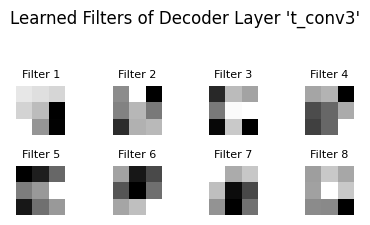

In [43]:
# Get the filters from your model
filters = model_12.t_conv3.weight.data.cpu()

# The shape is (out_channels, in_channels, height, width)
# For t_conv1, this will be (16, 16, 3, 3)
num_filters = filters.shape[0] # This will be 16

plt.figure(figsize=(4,4))
plt.suptitle("Learned Filters of Decoder Layer 't_conv3'")

# This layer has 16 input channels and 16 output channels.
# Each of the 16 "output" filters is actually a stack of 16 smaller 3x3 filters.
# Let's visualize the filters corresponding to the first input channel for simplicity.
for i in range(num_filters):
    ax = plt.subplot(4, 4, i + 1) # Arrange in a 4x4 grid

    # Get the i-th filter for the first input channel
    filter_data = filters[i, 0, :, :] # Shape: [3, 3]

    # --- NORMALIZATION STEP ---
    # Scale the filter's values to be between 0 and 1
    min_val = filter_data.min()
    max_val = filter_data.max()
    normalized_filter = (filter_data - min_val) / (max_val - min_val)

    # --- PLOT THE NORMALIZED DATA ---
    plt.imshow(normalized_filter, cmap='gray')
    ax.axis('off')
    ax.set_title(f"Filter {i+1}", size=8)

plt.tight_layout(rect=[0, 0.03, 1, 0.95]) # Adjust layout to make space for suptitle
plt.show()

The model demonstrates excellent convergence, as shown by the training and validation loss curves which flatten out after approximately 10 epochs. The final reconstruction error is very low, evident from the sharp and accurate reconstructions of the test images.
The visualized decoder weights are not random noise; instead, they have learned interpretable, primitive patterns like edges, corners, and gradients. The network uses these simple, learned "building blocks" to effectively draw and reconstruct the more complex digit shapes.